# __Welcome to the Navier image annotation and segmentation__

 All you need to do is to follow read this setup guide and follow any instructions given and you're good to go.

Run the cell below. (Only needed once per kernel session)

In [1]:
import os
HOME = '/home/navier/gdrive/segmentation'
print(f'Home directory: {HOME}')

%cd {HOME}

!pip install -q torch torchvision torchaudio
!pip install -q opencv-python pycocotools matplotlib onnxruntime onnx
!pip uninstall -y supervision
!pip install -q supervision==0.6.0
!pip install -q opencv-python matplotlib
!pip install 'git+https://github.com/facebookresearch/segment-anything.git'
!pip install -q roboflow
!wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth



!git clone https://github.com/IDEA-Research/GroundingDINO.git
%cd GroundingDINO
%pip install -e.
!mkdir weights
%cd weights
!wget -q https://github.com/IDEA-Research/GroundingDINO/releases/download/v0.1.0-alpha/groundingdino_swint_ogc.pth

%cd {HOME}

Home directory: /home/navier/gdrive/segmentation
/home/navier/gdrive/segmentation

[notice] A new release of pip is available: 23.1.2 -> 23.2
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 23.1.2 -> 23.2
[notice] To update, run: pip install --upgrade pip
Found existing installation: supervision 0.6.0
Uninstalling supervision-0.6.0:
  Successfully uninstalled supervision-0.6.0

[notice] A new release of pip is available: 23.1.2 -> 23.2
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 23.1.2 -> 23.2
[notice] To update, run: pip install --upgrade pip
  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-q79lg2s6
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-q79lg2s6
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27

# Step by step guide(changing variables in the cell block below):
1. (OPTIONAL) If you haven't already moved your images from a directory to Grounding SAMs image folder, give this variable your current path to your image directory if your images are not already in the dir_raw_images default path. Leave this variable as "" if your opting out:
>wrong_raw_path
***
2. (MANDATORY maybe) This will be the directory in which Grounding SAM will start working from. __If using in naviergpu, leave this variable unchanged:__
>dir_raw_images
***
3. (MANDATORY) Iterates through every image to validate file format. All files that are not .png will be converted. __If using in naviergpu, leave this variable unchanged:__
>batch_convert_path
***
4. (MANDATORY) Change paths of these variables to correct path for training, testing and validating model after Grounding SAM:
>dir_model_training_images

>dir_model_validating_images

>dir_model_training_labels

>dir_model_validating_labels
***
5. Go to cell below and hit "Execute Cell and Below" and follow every user input prompt coming up.
***
6. Repeat step 5 for every run you do this session
***

In [11]:
from toolbox import renameFiles, batchFileConverter, moveAllFiles, moveImagesAndLabels, emptyDirectory, validateImages, countFiles
"""Variables you may want to change before engaging with Grounding Sam"""

#Image paths; 
wrong_raw_path              = ""
dir_raw_images              = '/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images' #Leave unchanged if you are using this in naviergpu
batch_convert_path          = dir_raw_images #leave unchanged if you left dir_raw_images unchanged

#Yolo paths
dir_model_training_images   = "/home/navier/yolo/training_dataset/train/images"
dir_model_training_labels   = "/home/navier/yolo/training_dataset/train/labels"

dir_model_validating_images = "/home/navier/yolo/training_dataset/eval/images"
dir_model_validating_labels = "/home/navier/yolo/training_dataset/eval/labels"

#text_prompts
objects_to_prompt = "green marker.red marker.yellow marker"


# Toolbox methods and explanation:
    
### batchFileConverter(folder_path):     
Ensures file format: ".png"

***

### renameFiles(`folder_path`):
Renames files in `folder_path` to follow the conventions in code blocks below`

***

### moveAllFiles(`source_directory_path`, `target_directory_path`):
Use this method if you haven't already placed your raw images in the correct directory

- `source_directory_path` = the directory path where your raw images are currently placed

- `target_directory_path` = whichever path Grounding Sam works on. 
For naviergpu, you can assume the following path: 
>"/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images"

***

### moveImagesAndLabels(`dir_annotated`,  `dir_labels`, `train_images`, `train_labels`, `num_images` ):
- `dir_annotated` = the directory path of the annotated images. For naviergpu, you can assume the following path:
>'/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/annotated_images'


- `dir_labels` = Source directory of generated labels. For naviergpu, you can assume the following path:
>'/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/labels'


- `train_images` = The path of the image directory which you use to train your model.


- `train_labels` = The path of the labels directory which you use to train your model.


- `num_images`   = Number of annotated images you want to move from your annotated images directory to training, testing and/or evaluation

***

### emptyDirectory(`directory`, `file_format`):   # ".png", ".txt" ... and so on`

- `directory` = The directory path you want to empty


- `file_format` = ".png", ".txt" ... and so on`

***
See toolbox.py if you want to know more

In [4]:
if wrong_raw_path != "":
    moveAllFiles(wrong_raw_path, dir_raw_images)
batchFileConverter(dir_raw_images)
renameFiles(dir_raw_images)
validateImages(dir_raw_images)

0 images converted to .png


Variables, imports and model initiations

In [12]:
import os
HOME = '/home/navier/gdrive/segmentation'
print(f'Home directory: {HOME}')
#path = os.path.abspath('/home/navier/gdrive/Software/datasets/dataset_buoys_train/grounding_dino_dataset/images/')

%cd {HOME}

"""Please follow the naming conventions for image folders, else the code will break when extracting labels and maybe other places:
#Parent folders doesn't matter
images
annotated_images
masked_images"""

dir_images     = dir_raw_images                 #Starting directory
dir_annotated  = '/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/annotated_images'       #Annotated images directory
dir_masked     = '/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/masked_images'          #masked images directory
dir_labels     = '/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/labels'                 #labels export (binary mask)
dir_masked_only= '/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/mask_only_images'       #Images of mask from binary mask
dir_boxes_array= '/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/boxes_array/'            #Boxes array export

#Variables
file_name          = ''
file_strip         = 'image'
folder_split       = 'images'
objects_to_segment = objects_to_prompt
object_name        = objects_to_segment.split('.') 
box_treshold       = 0.40 #0.35
text_treshold      = 0.75 #0.25

#variables and imports (SAM)
import sys
from segment_anything import sam_model_registry, SamPredictor
sys.path.append("..")
sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type     = "vit_h"  #default
device         = "cuda"
sam            = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)
predictor      = SamPredictor(sam)
print('Sam checkpoint initiated')

%cd GroundingDINO/

#Variables and imports (Grounding Dino)
grounding_dino_config_path     = "groundingdino/config/GroundingDINO_SwinT_OGC.py"
grounding_dino_checkpoint_path = "weights/groundingdino_swint_ogc.pth"
grounding_dino_model_path      = "/home/navier/gdrive/segmentation/sam_vit_h_4b8939.pth"

from groundingdino.util.inference import load_model, load_image, predict, annotate, Model
grounding_dino_model = Model(model_config_path=grounding_dino_config_path, 
                             model_checkpoint_path=grounding_dino_checkpoint_path)

if os.path.isfile(grounding_dino_config_path):
    try:
        os.remove(f'{grounding_dino_config_path}.1')
    except:
        print(f'Copy of {grounding_dino_config_path} does not exist')

print(grounding_dino_checkpoint_path, "; exist:", os.path.isfile(grounding_dino_checkpoint_path))

if os.path.isfile(grounding_dino_checkpoint_path):
    try:
        os.remove(f'{grounding_dino_checkpoint_path}.1')
    except:
        print('Copy of {grounding_dino_checkpoint_path} does not exist ')
        
DINO_model = load_model(grounding_dino_config_path, grounding_dino_checkpoint_path)
DINO_model = DINO_model.to('cuda:0')
print('DINO checkpoint initiated')

#Imports
from groundingdino.util import box_ops
from typing import List
from PIL import Image
from IPython.display import clear_output
import supervision as sv
import torch
import cv2
import torch
import math
import torchvision
import numpy as np
import torch
import ast
DEVICE         = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Device is: {DEVICE}')
import matplotlib.pyplot as plt

%ls {HOME}



Home directory: /home/navier/gdrive/segmentation
/home/navier/gdrive/segmentation
Sam checkpoint initiated
/home/navier/gdrive/segmentation/GroundingDINO
final text_encoder_type: bert-base-uncased


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Copy of groundingdino/config/GroundingDINO_SwinT_OGC.py does not exist
weights/groundingdino_swint_ogc.pth ; exist: True
Copy of {grounding_dino_checkpoint_path} does not exist 
final text_encoder_type: bert-base-uncased


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


DINO checkpoint initiated
Device is: cuda
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
GroundingDINO/  sam_vit_h_4b8939.pth  weights/


# Grounding DINO

#### Initializes box annotation (Grounding Dino)

In [13]:
def detectBox(image_directory, 
              model, 
              text_prompt, 
              file_name):
    """Predicts bounding box and text from image and returns annotated image and it's variables"""
    image_source, image = load_image(image_directory)

    boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=text_prompt,
    box_threshold=box_treshold,
    text_threshold=text_treshold)


    annotated_frame = annotate(image_source=image_source, 
                               boxes=boxes, 
                               logits=logits, 
                               phrases=phrases)
    #annotated_frame = annotated_frame[...,::-1] # BGR to RGB if needed
    annotated_path =  os.path.join(dir_annotated, file_name)
    cv2.imwrite(annotated_path, annotated_frame)
    #cv2_imshow(annotated_frame) #Comment to skip product display below

    return annotated_frame, image_source, boxes, logits, phrases


### Run Dino (labelling and saving labels -> saving labels is coming later)

Processing box detection: image60.png


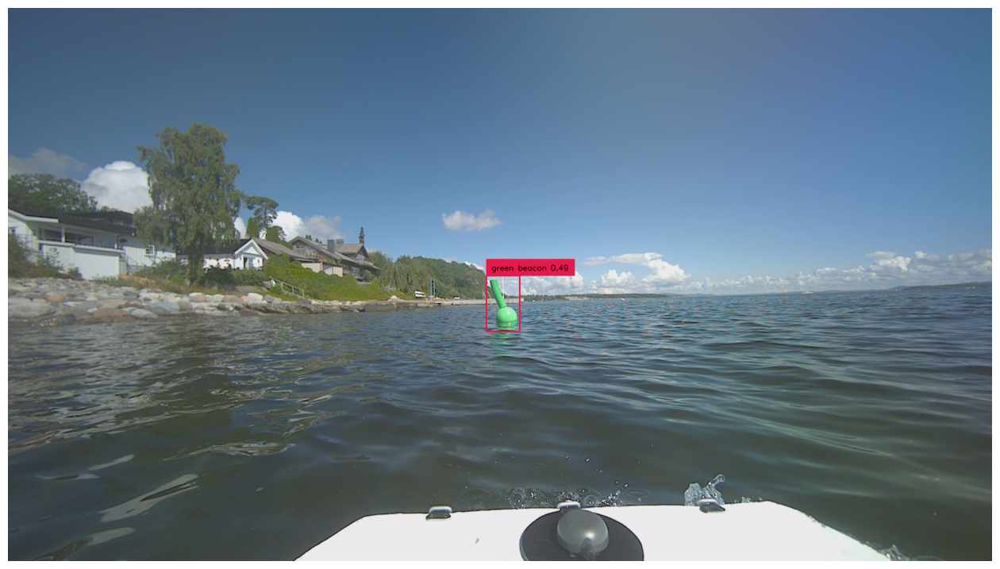

Processing box detection: image130.png


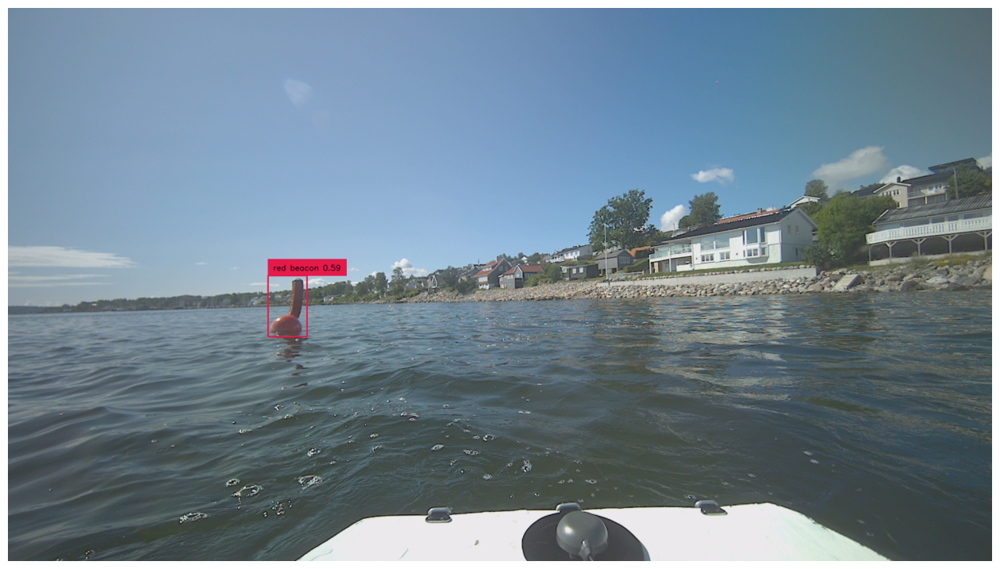

Processing box detection: image159.png


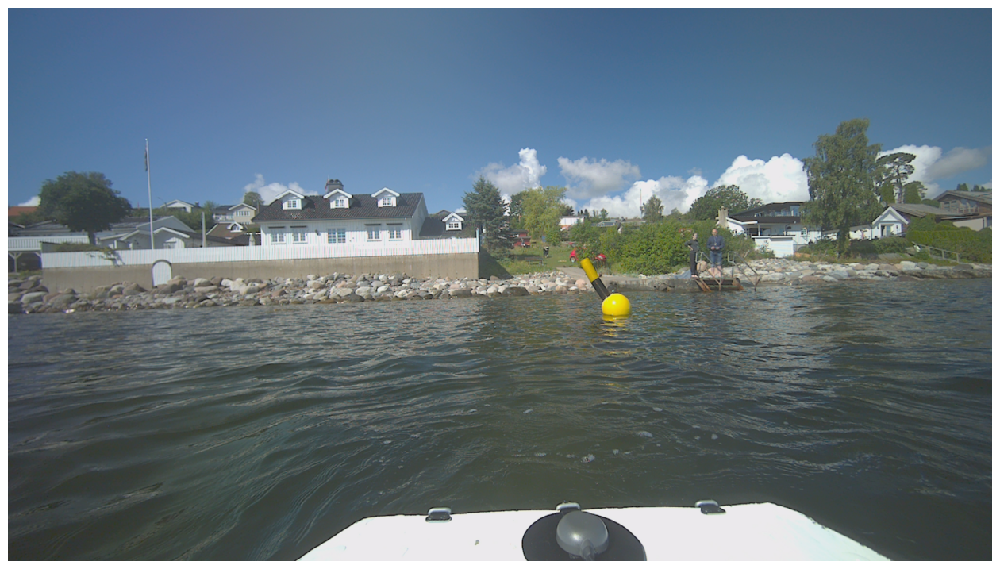

Processing box detection: image163.png


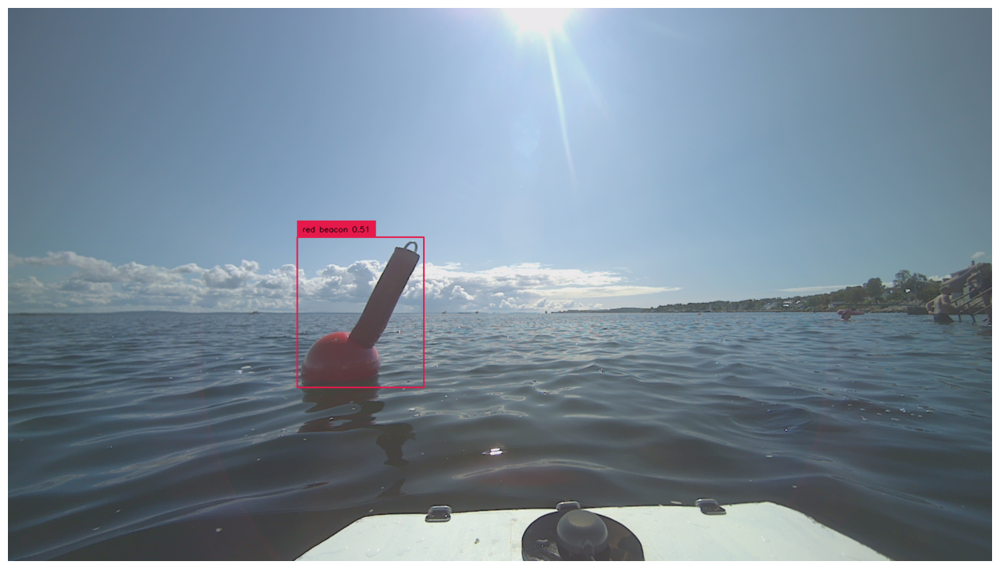

Processing box detection: image195.png


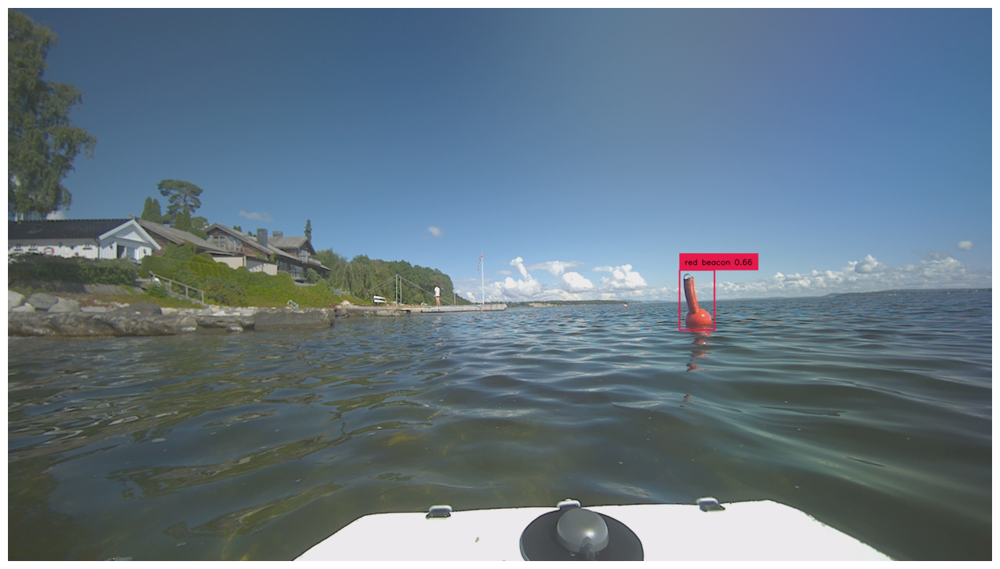

Processing box detection: image209.png


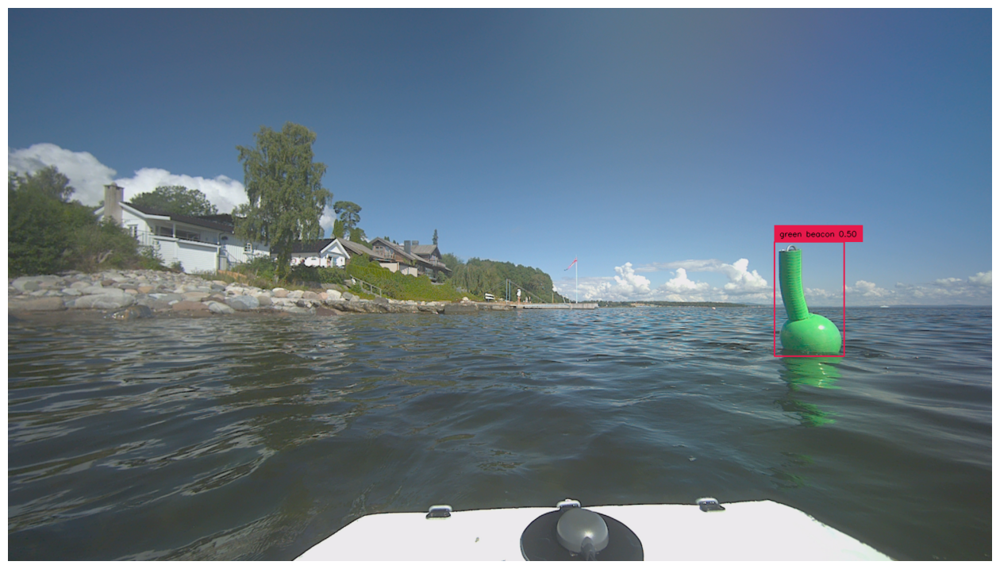

Processing box detection: image218.png


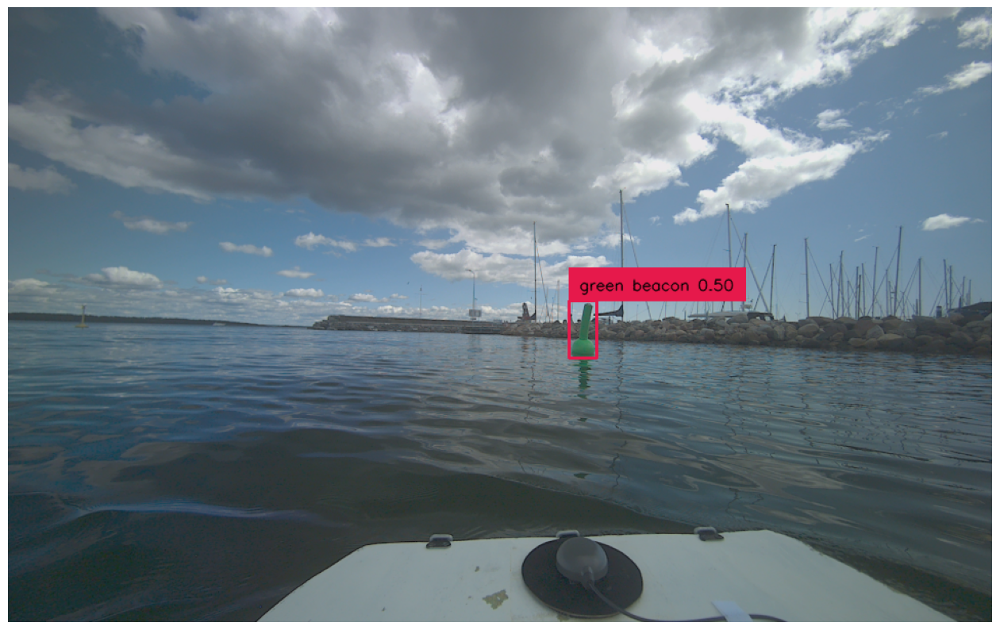

Processing box detection: image237.png


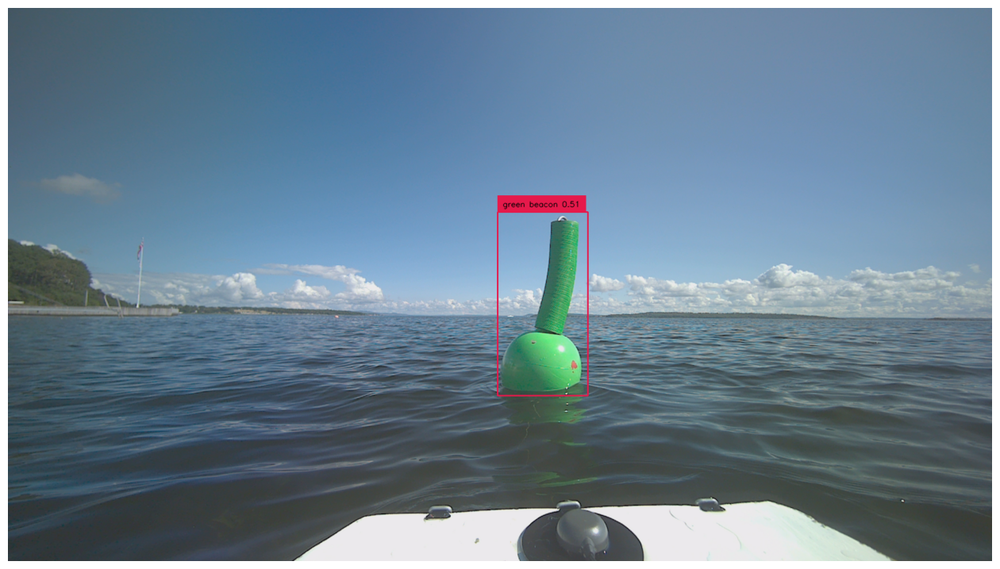

Processing box detection: image272.png


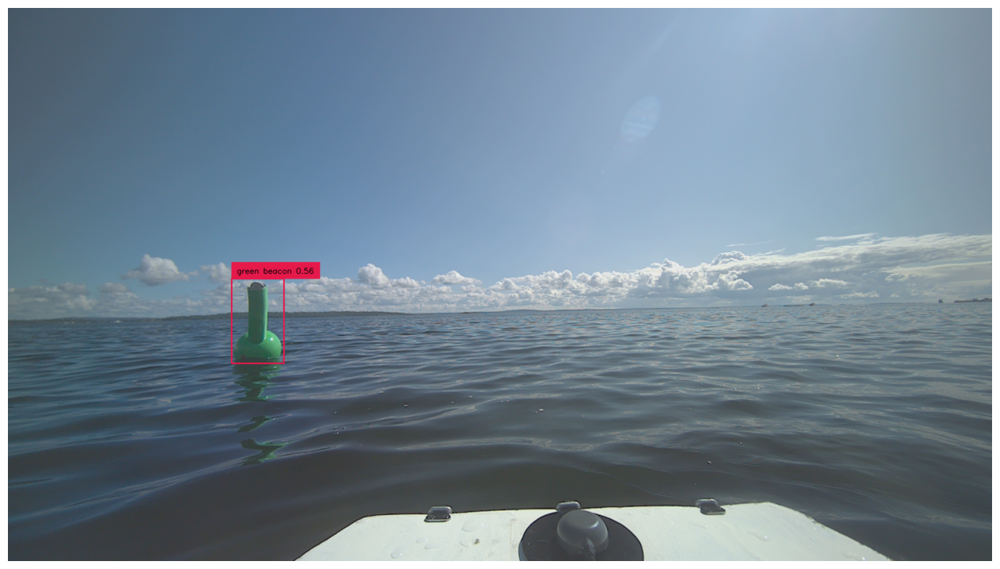

Processing box detection: image277.png


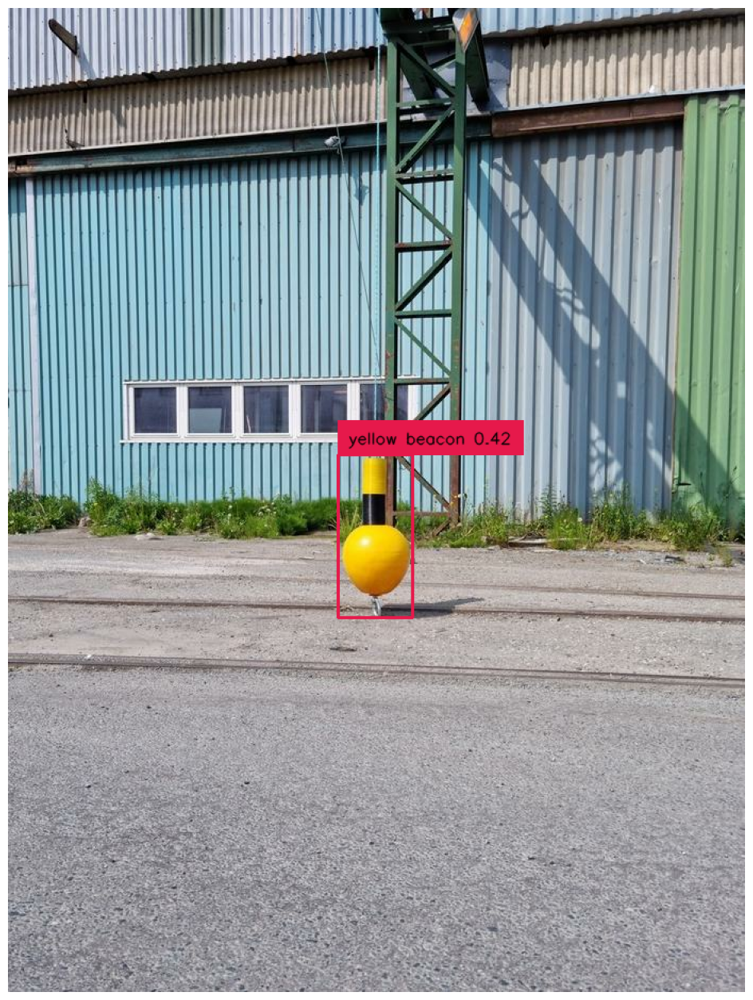

Processing box detection: image313.png


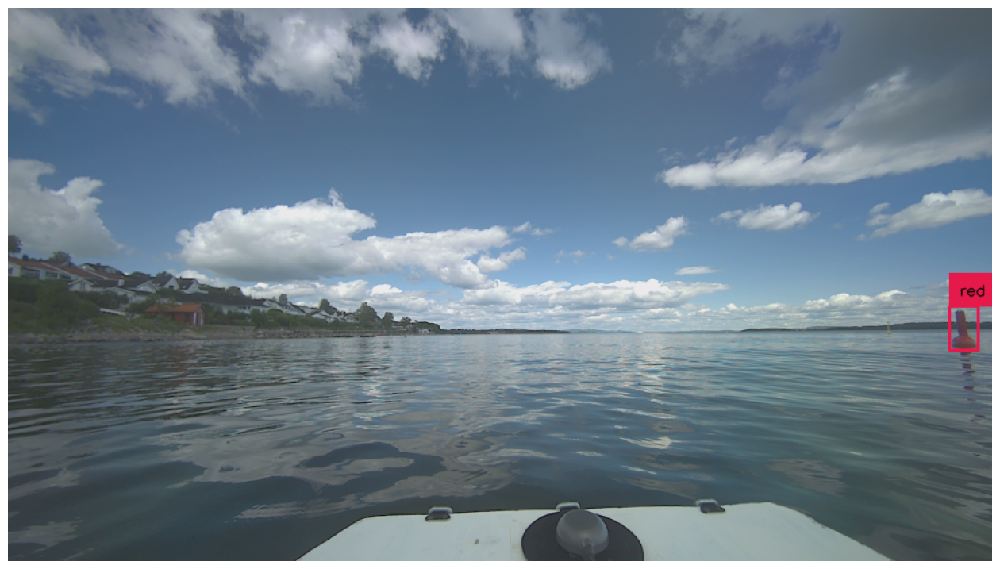

In [57]:
import matplotlib.pyplot as plt

box_treshold       = 0.39 #0.35
text_treshold      = 0.35 #0.25
objects_to_segment = "green beacon . red beacon . yellow beacon ."
object_name        = objects_to_segment.split('.') 
raw_image_count   = os.listdir(dir_images)
files = os.listdir(dir_images)
boxes_array       = np.zeros((len(raw_image_count), 3), dtype=object)
boxes_list = []

for n, file in enumerate(sorted(files, key=lambda x: int(x.strip(file_strip).rstrip(".png")))):
    file_name = file
    dino_raw_image_path = os.path.join(dir_images, file_name)
    print(f'Processing box detection: {file_name}')
    try:
        annotated_frame, _, boxes, _, phrases = detectBox(dino_raw_image_path, 
                                                               DINO_model, 
                                                               objects_to_segment, 
                                                               file_name)
    except Exception as e:
        print("couldnt process image, skipping" + str(e))
        break
    
    red_indexes   = [i for i, x in enumerate(phrases) if x == object_name[0]]
    green_indexes = [i for i, x in enumerate(phrases) if x == object_name[1]]
    cardinal_indexes = [i for i, x in enumerate(phrases) if x == object_name[2]]

    boxes_array   = np.array([[dino_raw_image_path, torch.unsqueeze(boxes[i], 0), object_name[0]] for i in red_indexes] + 
                             [[dino_raw_image_path, torch.unsqueeze(boxes[i], 0), object_name[1]] for i in green_indexes] +
                             [[dino_raw_image_path, torch.unsqueeze(boxes[i], 0), object_name[2]] for i in green_indexes],
                               dtype=object)      # [  0 ,   1  ,   2   ]
                                                  # [path, boxes, object] 
                                                  #                                               

    boxes_list.extend(boxes_array)
    boxes_array = np.array(boxes_list)
    cv2.imwrite(os.path.join(dir_annotated, file_name), annotated_frame)
    %matplotlib inline
    sv.plot_image(annotated_frame, (16, 16))
    if n == 10:
        break

In [58]:
print(boxes_array)

[['/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image130.png'
  tensor([[0.2842, 0.5400, 0.0394, 0.1103]]) 'red beacon']
 ['/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image130.png'
  tensor([[0.2842, 0.5400, 0.0394, 0.1103]]) 'yellow beacon']
 ['/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image163.png'
  tensor([[0.3584, 0.5510, 0.1287, 0.2711]]) 'red beacon']
 ['/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image163.png'
  tensor([[0.3584, 0.5510, 0.1287, 0.2711]]) 'yellow beacon']
 ['/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image195.png'
  tensor([[0.7003, 0.5287, 0.0356, 0.1083]]) 'red beacon']
 ['/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image195.png'
  tensor([[0.7003, 0.5287, 0.0356, 0.1083]]) 'yellow beacon']
 ['/hom

#### VALIDATE ANNOTATED IMAGE
You can't have much more fun than doing this

Previous file: 
Processing: image378.png
Image number: 1
Remaining images: 472


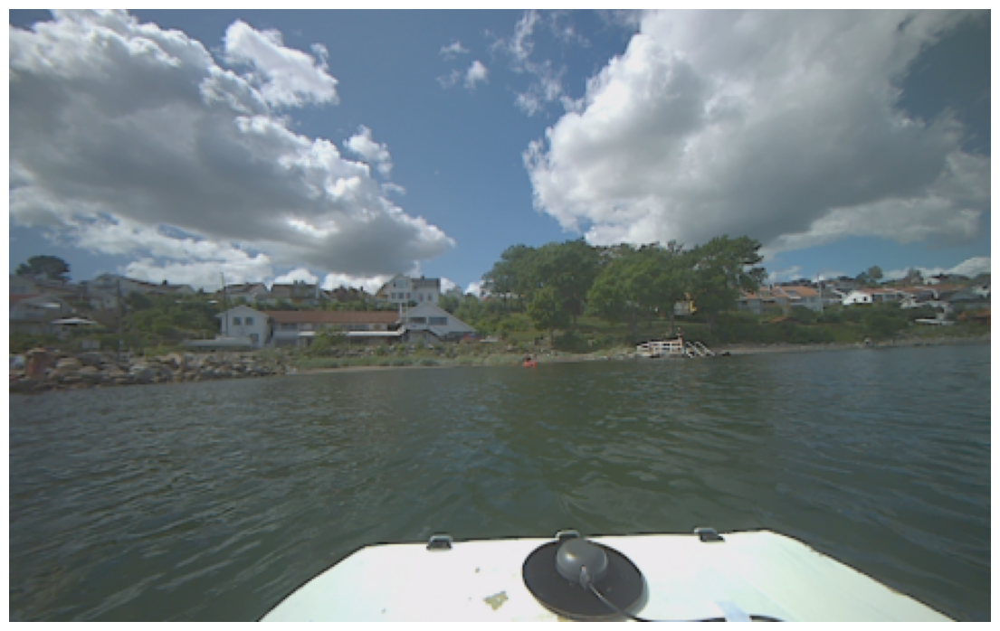

In [7]:
def imageProcessing(directory, raw_path):
    image_files = os.listdir(directory)
    previous_file = ''
    total_images = len(image_files)
    processed_images = 0
    for image_file in image_files:
            if image_file.endswith(('.png')):
                  annotated_image_path = os.path.join(directory, image_file)
                  print(f'Previous file: {previous_file}')
                  print(f'Processing: {image_file}')
                  print(f'Image number: {processed_images+1}\nRemaining images: {total_images - processed_images}')
                  # Open and display the image
                  image_path = os.path.join(directory, image_file)
                  image = plt.imread(image_path)
                  plt.figure(figsize=(14,14))
                  plt.imshow(image)
                  plt.axis('off')
                  plt.show()
                  user_input = input('K = keep image | D = delete image')
                  if user_input.lower() == 'k':
                        pass
                  elif user_input.lower() == 'd':
                        os.remove(image_path)
                        os.remove(raw_path)
                        pass
                  if user_input == 'X':
                        print("Keeping remaining images")
                        break
                  clear_output(wait=True)
                  previous_file = image_file
                  processed_images += 1
    return processed_images

validated_images = imageProcessing(dir_annotated, dir_images)

# Initializes Masking(SAM), and YOLO conversion

In [63]:
def show_mask(masks, ax, object):
    colors = {
        object_name[0]: np.array([0, 1, 0, 0.6]),
        object_name[1]: np.array([1, 0, 0, 0.6])
    }
    color = colors.get(object, np.array([0, 0, 1, 0.6]))
    h, w = masks.shape[-2:]
    mask_image = masks.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h   = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

image = cv2.imread(os.path.join(dir_images, file_name))
image = cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB)

def loadImage(image_source):
    """Loads image from source to be masked"""
    plt.figure(figsize=(10, 10))
    plt.imshow(image_source.squeeze())
        
    
def imageMasking(file_name, output_directory):
    """Masks image and saves it to output directory"""
    plt.axis('off')             #turn on to troubleshoot box placement for masking
    if file_name != 0:
        plt.savefig(f'{output_directory}/{file_name}', bbox_inches='tight', pad_inches=0)    
        #plt.show()            

def box_cxcywh_to_xyxy(x):
    """Converts boxes to xyxy"""
    x_c, y_c, w, h = x.unbind(-1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h), (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=-1)

def transformBox(image_directory, box):
    """transforms box and returns masks, xyxy coordinates of the box and the transformed box"""
    image_source, image = load_image(image_directory)
    predictor.set_image(image_source)
    result_masks = []
    H, W, _  = image_source.shape
    box_xyxy = box_cxcywh_to_xyxy(box).detach().cpu().numpy()[0]
   
    transformed_box = box_xyxy*[W, H, W, H]

    masks, scores, _ = predictor.predict(
        point_coords=None,
        point_labels=None,
        box=transformed_box,
        multimask_output=True,
    )
    score_index = np.argmax(scores)
    result_masks.append(masks[score_index])
    return image_source, result_masks, transformed_box, box_xyxy

def convert_to_yolo(mask, index):
    """Converts mask to yolo format"""
    yolo_format = str(index)
    xyxy = []

    for i, row in enumerate(mask):
        for j, element in enumerate(row):
            if element:
                x = j / len(row)
                y = i / len(mask)
                xyxy.extend([x, y])

    yolo_format += ' ' + ' '.join(map(str, xyxy))
    return yolo_format


### Run SAM
(Creates masked images and mask-only images)
(Converts xyxy to bounding coordinates and exports to YOLO-format for training)

8
/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image130.png
Label name: image130
/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image130.png
Label name: image130
/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image163.png
Label name: image163
/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image163.png
Label name: image163
/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image195.png
Label name: image195
/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image195.png
Label name: image195
/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image313.png
Label name: image313
/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/images/image313.png
Label name: image313


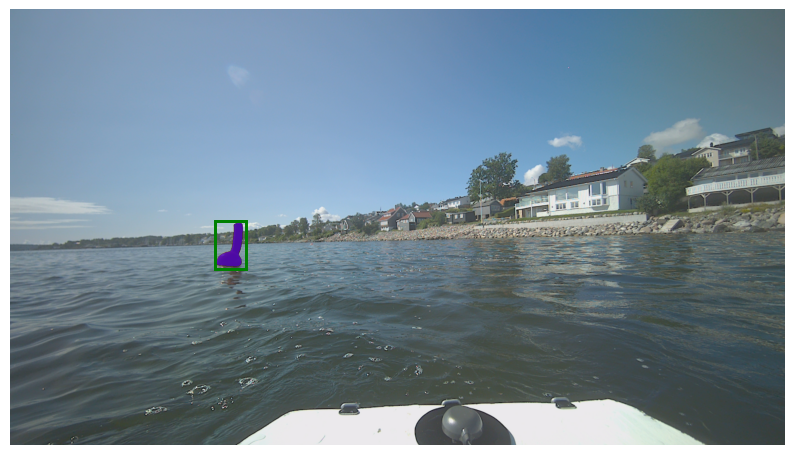

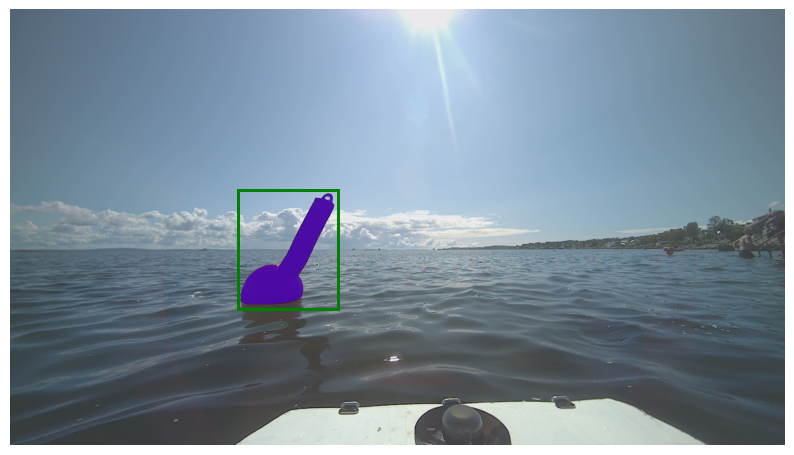

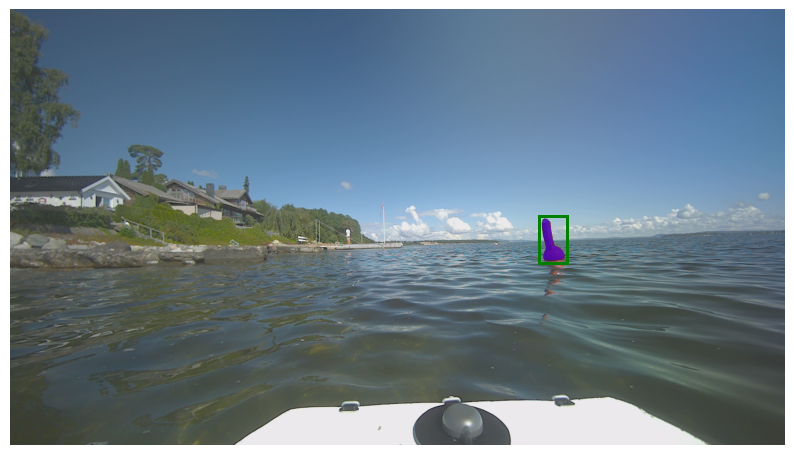

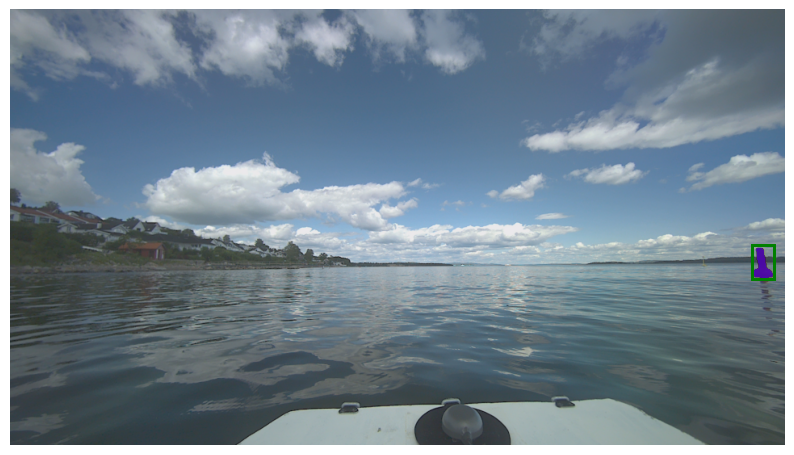

In [68]:
binary_masks_array    = np.zeros((len(boxes_array), 4), dtype=object)
transformed_box_array = np.zeros((len(boxes_array), 4), dtype=object)
no_mask_count = 0
file_check = ''
print(len(boxes_array))
for i in range(len(boxes_array)):
    print(boxes_array[i, 0])
    file_name      = boxes_array[i, 0].split('images/')[1]
    sam_image_path = os.path.join(dir_images, file_name)
    label_name     = file_name.rsplit('.png', 1)[0]
    label_path     = f'{dir_labels}/{label_name}.txt'
    try:
        image_source, masks, transformed_box, *_, = transformBox(sam_image_path, boxes_array[i, 1]) #Masked image
    except Exception as e:
        print(f'Couldnt get mask for this image: {file_name}\n  Exception: {e}')
        no_mask_count += 1
        with open(label_path, 'w') as file:
            file.write('')
        continue

    print(f'Label name: {label_name}')
    binary_masks_array[i, 0]    = file_name
    binary_masks_array[i, 1]    = masks
    binary_masks_array[i, 2]    = object_string    = boxes_array[i, 2]
    binary_masks_array[i, 3]    = image_source
    transformed_box_array[i, 0] = file_name
    transformed_box_array[i, 1] = transformed_box
    transformed_box_array[i, 2] = boxes_array[i, 2]
    transformed_box_array[i, 3] = image_source
    #Downscaling WIP, but maybe fuck it
        #Code goes here

    if (transformed_box_array[i, 2] == object_name[0]):
        yolo_format = convert_to_yolo(masks[0], 0)
    elif (transformed_box_array[i, 2] == object_name[1]):
        yolo_format = convert_to_yolo(masks[0], 1)
    elif (transformed_box_array[i, 2] == object_name[2]):
        yolo_format = convert_to_yolo(masks[0], 2) 
    if not os.path.isfile(label_path):
        with open(label_path, 'w') as file:
            file.write(f'{str(yolo_format)}\n')
    else:
        with open(label_path, 'a') as file:
            file.write(f'{str(yolo_format)}\n')
if binary_masks_array[i, 0] != 'empty':                                                     
    loadImage(binary_masks_array[0, 3])
    for i, file in enumerate(binary_masks_array[:, 0]):
        if file != file_check:
            if file_check != '':
                imageMasking(file_check, dir_masked)
                loadImage(binary_masks_array[i, 3])
            file_check = file
        if file == file_check:
            for mask in binary_masks_array[i, 1]:
                show_mask(binary_masks_array[i, 1][0], plt.gca(), binary_masks_array[i, 2])
                show_box(transformed_box_array[i, 1], plt.gca())     #uncomment if you want to display box
                imageMasking(binary_masks_array[-1, 0], dir_masked)

### Moves x, y, z number of images to training, validating and testing directories

In [12]:
number_of_files     = countFiles(dir_images)
train_num_images    = int(input(f"Select how many images to TRAIN your model. There are {number_of_files} in image directory."))
number_of_files     = countFiles(dir_images)
validate_num_images = int(input(f"Select how many images to VALIDATE your model. There are {number_of_files} in image directory."))
number_of_files     = countFiles(dir_images)
try:
    moveImagesAndLabels(dir_annotated, dir_labels, dir_model_training_images, dir_model_training_labels, train_num_images)
    moveImagesAndLabels(dir_annotated, dir_labels, dir_model_validating_images, dir_model_validating_labels, validate_num_images)
except:
    pass

Could not not move annotated images and labels to training directories
Error: [Errno 2] No such file or directory: '/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/labels/image13.txt'
Could not not move annotated images and labels to training directories
Error: [Errno 2] No such file or directory: '/home/navier/gdrive/software/datasets/dataset_buoys_train/grounding_dino_dataset/labels/image154.txt'


##Create mask-only files:
Commented out because this serves noe useful purpose other than showcasing

In [ ]:
#for k in range(len(binary_masks_array)):
#  for image in binary_masks_array[k, 1]: #Generates TypeError for last k in queue if there is no object to iterate, but don't bother handling the exception, because it doesn't matter
#      try:
#          print(f'Label name: {binary_masks_array[k, 0]}\nObject Name: {binary_masks_array[k, 2]}')
#          plt.imshow(image.squeeze(), cmap='gray')
#          plt.axis('off')
#          output_file = os.path.join(dir_masked_only, binary_masks_array[k, 0])
#          plt.savefig(f'{output_file}', bbox_inches='tight', pad_inches=0)      #Uncomment to not save fig
#          #plt.show()                                                            #Uncomment to display product below
#      except AttributeError:
#          pass

### If you need to empty any directory, uncomment the line below and set your desired directory and file format as in-arguments

In [24]:
#emptyDirectory("/home/navier/yolo/training_dataset/eval/images", ".png")